<a href="https://colab.research.google.com/github/clarissanjani/ECML_PKDD_TaxiTrajectoryPrediction/blob/main/AS_LSCM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Approach WITHOUT Points of Interest Data

# I. Initial Setup

In this section, the focus is on the Basic Approach without the Points of Interest data, the last section includes the implementation of the approach WITH Points of Interest data.

### 1. Import Packages

Import numpy and pandas

In [1]:
import pandas as pd
import numpy as np

Import other libraries

In [2]:
import zipfile
import datetime
import statistics

Import for data preprocessing

In [3]:
import re

Import visualization libraries

In [4]:
%pip install matplotlib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
import folium
import seaborn as sns
sns.set_theme(style="ticks", color_codes=True)
import matplotlib.pyplot as plt
from matplotlib.ticker import  MultipleLocator, FormatStrFormatter
%matplotlib inline

import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from folium import plugins
from folium.plugins import HeatMap

Sklearn packages

In [6]:
# data preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

# Random forest
from sklearn.ensemble import RandomForestRegressor
from sklearn.multioutput import MultiOutputRegressor

# parameter opimization
from sklearn.model_selection import GridSearchCV

# Validation
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

Install the Kaggle API in Colab

In [7]:
! pip install -q kaggle

### 2. Authenticating with Kaggle using kaggle.json

Source: https://colab.research.google.com/github/corrieann/kaggle/blob/master/kaggle_api_in_colab.ipynb

In [8]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))
  
# Then move kaggle.json into the folder where the API expects to find it.
!mkdir -p ~/.kaggle/ && mv kaggle.json ~/.kaggle/ && chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json
User uploaded file "kaggle.json" with length 70 bytes


In [9]:
!kaggle competitions list

ref                                            deadline             category            reward  teamCount  userHasEntered  
---------------------------------------------  -------------------  ---------------  ---------  ---------  --------------  
contradictory-my-dear-watson                   2030-07-01 23:59:00  Getting Started     Prizes         45           False  
gan-getting-started                            2030-07-01 23:59:00  Getting Started     Prizes        104           False  
store-sales-time-series-forecasting            2030-06-30 23:59:00  Getting Started  Knowledge        622           False  
tpu-getting-started                            2030-06-03 23:59:00  Getting Started  Knowledge        125           False  
digit-recognizer                               2030-01-01 00:00:00  Getting Started  Knowledge       1321           False  
titanic                                        2030-01-01 00:00:00  Getting Started  Knowledge      14790           False  
house-pr

### 3. Downloading data set from Kaggle

In [10]:
!kaggle competitions download -c pkdd-15-predict-taxi-service-trajectory-i

pkdd-15-predict-taxi-service-trajectory-i.zip: Skipping, found more recently modified local copy (use --force to force download)


## Loading the Data

In [11]:
!unzip pkdd-15-predict-taxi-service-trajectory-i.zip

Archive:  pkdd-15-predict-taxi-service-trajectory-i.zip
replace evaluation_script.r? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: evaluation_script.r     
replace metaData_taxistandsID_name_GPSlocation.csv.zip? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: metaData_taxistandsID_name_GPSlocation.csv.zip  
replace sampleSubmission.csv.zip? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: sampleSubmission.csv.zip  
replace test.csv.zip? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: test.csv.zip            
replace train.csv.zip? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: train.csv.zip           


In [12]:
!unzip metaData_taxistandsID_name_GPSlocation.csv.zip

Archive:  metaData_taxistandsID_name_GPSlocation.csv.zip
replace metaData_taxistandsID_name_GPSlocation.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: metaData_taxistandsID_name_GPSlocation.csv  
replace __MACOSX/._metaData_taxistandsID_name_GPSlocation.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: __MACOSX/._metaData_taxistandsID_name_GPSlocation.csv  


In [13]:
!unzip sampleSubmission.csv.zip

Archive:  sampleSubmission.csv.zip
replace sampleSubmission.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: sampleSubmission.csv    


In [14]:
!unzip test.csv.zip

Archive:  test.csv.zip
replace test.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: test.csv                


In [15]:
!unzip train.csv.zip

Archive:  train.csv.zip
replace train.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: train.csv               


In [16]:
## Taxi Stands Location
GPSlocation_df = pd.read_csv("metaData_taxistandsID_name_GPSlocation.csv")
GPSlocation_df.head()

,ID,Descricao,Latitude,Longitude
0,1,Agra,41.1771457135,-8.609670
1,2,Alameda,41.15618964,-8.591064
2,3,Aldoar,41.1705249231,-8.665876
3,4,Alfândega,41.1437639911,-8.621803
4,5,Amial,41.1835097223,-8.612726


In [17]:
# Sample submission
sampleSubmission_df = pd.read_csv("sampleSubmission.csv")
sampleSubmission_df.head()

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.146504,-8.611317
1,T2,41.146504,-8.611317
2,T3,41.146504,-8.611317
3,T4,41.146504,-8.611317
4,T5,41.146504,-8.611317


In [18]:
# Test
test_df = pd.read_csv("test.csv")
test_df.head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE
0,T1,B,NaN,15.0,20000542,1408039037,A,False,"[[-8.585676,41.148522],[-8.585712,41.148639],[..."
1,T2,B,NaN,57.0,20000108,1408038611,A,False,"[[-8.610876,41.14557],[-8.610858,41.145579],[-..."
2,T3,B,NaN,15.0,20000370,1408038568,A,False,"[[-8.585739,41.148558],[-8.58573,41.148828],[-..."
3,T4,B,NaN,53.0,20000492,1408039090,A,False,"[[-8.613963,41.141169],[-8.614125,41.141124],[..."
4,T5,B,NaN,18.0,20000621,1408039177,A,False,"[[-8.619903,41.148036],[-8.619894,41.148036]]"


In [19]:
# Train Data
train_df = pd.read_csv("train.csv")
train_df.head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE
0,1372636858620000589,C,NaN,NaN,20000589,1372636858,A,False,"[[-8.618643,41.141412],[-8.618499,41.141376],[..."
1,1372637303620000596,B,NaN,7.0,20000596,1372637303,A,False,"[[-8.639847,41.159826],[-8.640351,41.159871],[..."
2,1372636951620000320,C,NaN,NaN,20000320,1372636951,A,False,"[[-8.612964,41.140359],[-8.613378,41.14035],[-..."
3,1372636854620000520,C,NaN,NaN,20000520,1372636854,A,False,"[[-8.574678,41.151951],[-8.574705,41.151942],[..."
4,1372637091620000337,C,NaN,NaN,20000337,1372637091,A,False,"[[-8.645994,41.18049],[-8.645949,41.180517],[-..."


# II. Data Preprocessing

## Location analysis

### Add first & last longitude

https://www.kaggle.com/code/dahouda/taxi-trajectory-prediction-i

In [20]:
# First longitude
lists_1st_lon = []
for i in range(0,len(train_df["POLYLINE"])):
    if train_df["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lon.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", train_df["POLYLINE"][i]).split(",")[0]
        lists_1st_lon.append(k)
        
train_df["lon_1st"] = lists_1st_lon

# First latitude
lists_1st_lat = []
for i in range(0,len(train_df["POLYLINE"])):
    if train_df["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", train_df["POLYLINE"][i]).split(",")[1]
        lists_1st_lat.append(k)
        
train_df["lat_1st"] = lists_1st_lat

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: Possible nested set at position 1
  


In [21]:
# Last longitude
lists_last_lon = []
for i in range(0,len(train_df["POLYLINE"])):
        if train_df["POLYLINE"][i] == '[]':
            k=0
            lists_last_lon.append(k)
        else:
            k = re.sub(r"[[|[|]|]|]]", "", train_df["POLYLINE"][i]).split(",")[-2]
            lists_last_lon.append(k)

train_df["lon_last"] = lists_last_lon

# Last latitude
lists_last_lat = []
for i in range(0,len(train_df["POLYLINE"])):
    if train_df["POLYLINE"][i] == '[]':
        k=0
        lists_last_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", train_df["POLYLINE"][i]).split(",")[-1]
        lists_last_lat.append(k)
        
train_df["lat_last"] = lists_last_lat

In [22]:
%%time
# Delete lon & lat have "0".
train_df = train_df.query("lon_last != 0")

CPU times: user 979 ms, sys: 302 ms, total: 1.28 s
Wall time: 1.29 s


In [23]:
%%time
train_df["lon_1st"] = [float(k) for k in train_df["lon_1st"]]
train_df["lat_1st"] = [float(k) for k in train_df["lat_1st"]]
train_df["lon_last"] = [float(k) for k in train_df["lon_last"]]
train_df["lat_last"] = [float(k) for k in train_df["lat_last"]]

CPU times: user 3.16 s, sys: 256 ms, total: 3.41 s
Wall time: 3.42 s


### Create test lon and lat in test 

In [24]:
%%time
# First longitude
lists_1st_lon = []
for i in range(0,len(test_df["POLYLINE"])):
    if test_df["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lon.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", test_df["POLYLINE"][i]).split(",")[0]
        lists_1st_lon.append(k)
        
test_df["lon_1st"] = lists_1st_lon

# First latitude
lists_1st_lat = []
for i in range(0,len(test_df["POLYLINE"])):
    if test_df["POLYLINE"][i] == '[]':
        k=0
        lists_1st_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", test_df["POLYLINE"][i]).split(",")[1]
        lists_1st_lat.append(k)
        
test_df["lat_1st"] = lists_1st_lat

CPU times: user 52.2 ms, sys: 0 ns, total: 52.2 ms
Wall time: 53.5 ms


In [25]:
%%time
# Last longitude
lists_last_lon = []
for i in range(0,len(test_df["POLYLINE"])):
        if test_df["POLYLINE"][i] == '[]':
            k=0
            lists_last_lon.append(k)
        else:
            k = re.sub(r"[[|[|]|]|]]", "", test_df["POLYLINE"][i]).split(",")[-2]
            lists_last_lon.append(k)

test_df["lon_last"] = lists_last_lon

# Last latitude
lists_last_lat = []
for i in range(0,len(test_df["POLYLINE"])):
    if test_df["POLYLINE"][i] == '[]':
        k=0
        lists_last_lat.append(k)
    else:
        k = re.sub(r"[[|[|]|]|]]", "", test_df["POLYLINE"][i]).split(",")[-1]
        lists_last_lat.append(k)
        
test_df["lat_last"] = lists_last_lat

CPU times: user 39.2 ms, sys: 0 ns, total: 39.2 ms
Wall time: 40 ms


In [26]:
%%time
# Delete lon & lat have "0".
test_df = test_df.query("lon_last != 0")

CPU times: user 4.32 ms, sys: 1.01 ms, total: 5.32 ms
Wall time: 7.29 ms


In [27]:
%%time
test_df["lon_1st"] = [float(k) for k in test_df["lon_1st"]]
test_df["lat_1st"] = [float(k) for k in test_df["lat_1st"]]
test_df["lon_last"] = [float(k) for k in test_df["lon_last"]]
test_df["lat_last"] = [float(k) for k in test_df["lat_last"]]

CPU times: user 2.14 ms, sys: 2 µs, total: 2.14 ms
Wall time: 2.15 ms


### Route analysis before preprocessing

In [30]:
train_df['ORIGIN_CALL'].value_counts()

2002.0     57487
63882.0     6401
2001.0      2488
13168.0     1314
6728.0      1114
           ...  
56879.0        1
14476.0        1
43307.0        1
40804.0        1
34164.0        1
Name: ORIGIN_CALL, Length: 57074, dtype: int64

In [31]:
routes_analysis_df = train_df.copy()

In [32]:
routes_analysis_df['ORIGIN_CALL'].value_counts()

2002.0     57487
63882.0     6401
2001.0      2488
13168.0     1314
6728.0      1114
           ...  
56879.0        1
14476.0        1
43307.0        1
40804.0        1
34164.0        1
Name: ORIGIN_CALL, Length: 57074, dtype: int64

In [33]:
# understanding the spread of call iDs
count_origin_call = routes_analysis_df.ORIGIN_CALL.value_counts()
count_origin_call[count_origin_call > 200]

2002.0     57487
63882.0     6401
2001.0      2488
13168.0     1314
6728.0      1114
           ...  
6715.0       211
34861.0      210
18820.0      206
15420.0      205
15356.0      201
Name: ORIGIN_CALL, Length: 68, dtype: int64

Review most visited route, call ID 2002

In [34]:
row_2002 = routes_analysis_df.loc[routes_analysis_df['ORIGIN_CALL'] == 2002]

In [35]:
# review if there is a trend in the destinations
row_2002['lon_last'].value_counts()

-8.585658    195
-8.585640    190
-8.585667    188
-8.585649    183
-8.585676    177
            ... 
-8.562996      1
-8.622288      1
-8.643600      1
-8.651979      1
-8.661141      1
Name: lon_last, Length: 13066, dtype: int64

In [36]:
map_rob = folium.Map(location=[41.141412,-8.590324], zoom_start=10, tiles='Stamen Terrain')
mapping_1st = pd.DataFrame({
    "lat":row_2002.head(5000)["lat_1st"].values,
    "lon":row_2002.head(5000)["lon_1st"].values,
})

heat_data_1 = [[row['lat'],row[ 'lon']] for index, row in mapping_1st.iterrows()]

mapping_lst = pd.DataFrame({
    "lat":row_2002.head(5000)["lat_last"].values,
    "lon":row_2002.head(5000)["lon_last"].values,
})

heat_data_2 = [[row['lat'],row[ 'lon']] for index, row in mapping_lst.iterrows()]

heat_data = heat_data_2

# Plot it on the map
HeatMap(heat_data).add_to(map_rob)

# Display the map
map_rob

Review another route: call ID 34861

In [37]:
# examining another random trip and if there is a pattern
row_34861 = routes_analysis_df.loc[routes_analysis_df['ORIGIN_CALL'] == 34861]

In [38]:
# review if there is a trend in the destinations
row_34861['lon_last'].value_counts()

-8.626860    10
-8.626950     8
-8.626914     8
-8.626905     7
-8.626851     6
             ..
-8.626050     1
-8.570520     1
-8.600589     1
-8.627013     1
-8.627598     1
Name: lon_last, Length: 103, dtype: int64

In [39]:
map_rob = folium.Map(location=[41.141412,-8.590324], zoom_start=10, tiles='Stamen Terrain')

mapping_1st = pd.DataFrame({
    "lat":row_34861.head(5000)["lat_1st"].values,
    "lon":row_34861.head(5000)["lon_1st"].values,
})

heat_data_1 = [[row['lat'],row[ 'lon']] for index, row in mapping_1st.iterrows()]

mapping_lst = pd.DataFrame({
    "lat":row_34861.head(5000)["lat_last"].values,
    "lon":row_34861.head(5000)["lon_last"].values,
})

heat_data_2 = [[row['lat'],row[ 'lon']] for index, row in mapping_lst.iterrows()]

heat_data = heat_data_2

# Plot it on the map
HeatMap(heat_data).add_to(map_rob)

# Display the map
map_rob

## Analyse the missing data

In [40]:
train_df['MISSING_DATA'].value_counts()

False    1704759
True          10
Name: MISSING_DATA, dtype: int64

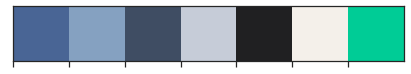

In [41]:
# Defining all our palette colours.- source: https://www.kaggle.com/code/dahouda/taxi-trajectory-prediction-i
primary_blue = "#496595"
primary_blue2 = "#85a1c1"
primary_blue3 = "#3f4d63"
primary_grey = "#c6ccd8"
primary_black = "#202022"
primary_bgcolor = "#f4f0ea"

primary_green = px.colors.qualitative.Plotly[2]

plt.rcParams['axes.facecolor'] = primary_bgcolor

colors = [primary_blue, primary_blue2, primary_blue3, primary_grey, primary_black, primary_bgcolor, primary_green]
sns.palplot(sns.color_palette(colors))

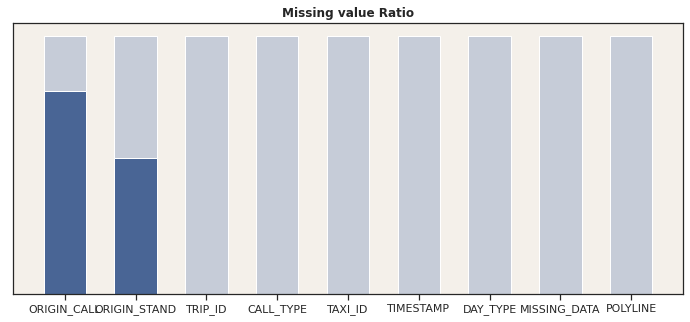

In [42]:
# Checking Missing Values - source: https://www.kaggle.com/code/dahouda/taxi-trajectory-prediction-i
nan_data = (train_df.isna().sum().sort_values(ascending=False) / len(train_df) * 100)[:9]
fig, ax = plt.subplots(1,1,figsize=(12, 5))

ax.bar(nan_data.index, 100, color=primary_grey, width=0.6)

bar = ax.bar(
    nan_data.index, 
    nan_data, 
    color=primary_blue, 
    width=0.6
)
# ax.bar_label(bar, fmt='%.01f %%')
# ax.spines.left.set_visible(False)
ax.set_yticks([])
ax.set_title('Missing value Ratio', fontweight='bold')

plt.show()

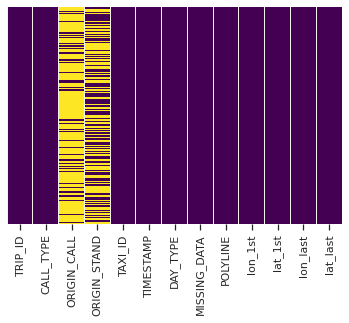

In [43]:
# another way to check for missing values
sns.heatmap(train_df.isnull(),yticklabels=False,cbar=False,cmap='viridis')

## Convert timestamps into readable form

In [28]:
# Reformat timestamp to understandable date/time
train_df["TIMESTAMP"] = [float(time) for time in train_df["TIMESTAMP"]]
train_df["formatted_timestamp"] = [datetime.datetime.fromtimestamp(time, datetime.timezone.utc) for time in train_df["TIMESTAMP"]]

In [29]:
# Break down formatted time stamp into year, month, day, hour, min, weekday
train_df["Year"] = train_df["formatted_timestamp"].dt.year
train_df["Month"] = train_df["formatted_timestamp"].dt.month
train_df["Day"] = train_df["formatted_timestamp"].dt.day
train_df["Hour"] = train_df["formatted_timestamp"].dt.hour
train_df["Minute"] = train_df["formatted_timestamp"].dt.minute
train_df["Weekday"] = train_df["formatted_timestamp"].dt.weekday
train_df['Week of Year'] = train_df["formatted_timestamp"].dt.weekofyear - 1
# get day of week
train_df['Day of Week']=train_df.formatted_timestamp.dt.day_name()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  


In [46]:
train_df.head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,lon_1st,...,lat_last,formatted_timestamp,Year,Month,Day,Hour,Minute,Weekday,Week of Year,Day of Week
0,1372636858620000589,C,NaN,NaN,20000589,1.372637e+09,A,False,"[[-8.618643,41.141412],[-8.618499,41.141376],[...",-8.618643,...,41.154489,2013-07-01 00:00:58+00:00,2013,7,1,0,0,0,26,Monday
1,1372637303620000596,B,NaN,7.0,20000596,1.372637e+09,A,False,"[[-8.639847,41.159826],[-8.640351,41.159871],[...",-8.639847,...,41.170671,2013-07-01 00:08:23+00:00,2013,7,1,0,8,0,26,Monday
2,1372636951620000320,C,NaN,NaN,20000320,1.372637e+09,A,False,"[[-8.612964,41.140359],[-8.613378,41.14035],[-...",-8.612964,...,41.140530,2013-07-01 00:02:31+00:00,2013,7,1,0,2,0,26,Monday
3,1372636854620000520,C,NaN,NaN,20000520,1.372637e+09,A,False,"[[-8.574678,41.151951],[-8.574705,41.151942],[...",-8.574678,...,41.142915,2013-07-01 00:00:54+00:00,2013,7,1,0,0,0,26,Monday
4,1372637091620000337,C,NaN,NaN,20000337,1.372637e+09,A,False,"[[-8.645994,41.18049],[-8.645949,41.180517],[-...",-8.645994,...,41.178087,2013-07-01 00:04:51+00:00,2013,7,1,0,4,0,26,Monday


Do the same preprocessing in the test dataset

In [30]:
# Reformat timestamp to understandable date/time
test_df["TIMESTAMP"] = [float(time) for time in test_df["TIMESTAMP"]]
test_df["formatted_timestamp"] = [datetime.datetime.fromtimestamp(time, datetime.timezone.utc) for time in test_df["TIMESTAMP"]]

In [44]:
# Break down formatted time stamp into year, month, day, hour, min, weekday
test_df["Year"] = test_df["formatted_timestamp"].dt.year
test_df["Month"] = test_df["formatted_timestamp"].dt.month
test_df["Day"] = test_df["formatted_timestamp"].dt.day
test_df["Hour"] = test_df["formatted_timestamp"].dt.hour
test_df["Minute"] = test_df["formatted_timestamp"].dt.minute
test_df["Weekday"] = test_df["formatted_timestamp"].dt.weekday
train_df['Week of Year'] = train_df["formatted_timestamp"].dt.weekofyear - 1
# get day of week
test_df['Day of Week']=test_df.formatted_timestamp.dt.day_name()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  


## Create categorical values from CALL_TYPE and MISSING_DATA

In [31]:
# MISSING_DATA
def miss_flg(x):
    if x["MISSING_DATA"] == "False":
        res = 0
    else:
        res = 1
    return res

train_df["MISSING_DATA"] = train_df.apply(miss_flg, axis=1)

In [32]:
# CALL_TYPES
map_call = {"A":1, "B":2, "C":3}
train_df["CALL_TYPE_CAT"] = train_df["CALL_TYPE"].map(map_call)


Do it in the test dataset

In [33]:
map_call = {"A":1, "B":2, "C":3}
test_df["CALL_TYPE_CAT"] = test_df["CALL_TYPE"].map(map_call)

Do it in the test dataset

In [34]:
test_df["MISSING_DATA"] = test_df.apply(miss_flg, axis=1)

## Change NaN Values in ORIGIN_STAND and ORIGIN_CALL

In [35]:
# Origin_stand
def origin_stand_flg(x):
    if x["ORIGIN_STAND"] == None:
        res = 0
    else:
        res=1
    return res

train_df["ORIGIN_STAND"] = train_df.apply(origin_stand_flg, axis=1)

Do it in the test dataset too

In [36]:
test_df["ORIGIN_STAND"] = test_df.apply(origin_stand_flg, axis=1)

In [37]:
# Origin_call
def origin_call_flg(x):
    if x["ORIGIN_CALL"] == None:
        res = 0
    else:
        res = 1
    return res

train_df["ORIGIN_CALL"] = train_df.apply(origin_call_flg, axis=1)

Do it in the test dataset too

In [38]:
test_df["ORIGIN_CALL"] = test_df.apply(origin_call_flg, axis=1)

## See types of data in datasets

In [57]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1704769 entries, 0 to 1710669
Data columns (total 23 columns):
 #   Column               Dtype              
---  ------               -----              
 0   TRIP_ID              int64              
 1   CALL_TYPE            object             
 2   ORIGIN_CALL          int64              
 3   ORIGIN_STAND         int64              
 4   TAXI_ID              int64              
 5   TIMESTAMP            float64            
 6   DAY_TYPE             object             
 7   MISSING_DATA         int64              
 8   POLYLINE             object             
 9   lon_1st              float64            
 10  lat_1st              float64            
 11  lon_last             float64            
 12  lat_last             float64            
 13  formatted_timestamp  datetime64[ns, UTC]
 14  Year                 int64              
 15  Month                int64              
 16  Day                  int64              
 17  Hour    

In [58]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 320 entries, 0 to 319
Data columns (total 22 columns):
 #   Column               Non-Null Count  Dtype              
---  ------               --------------  -----              
 0   TRIP_ID              320 non-null    object             
 1   CALL_TYPE            320 non-null    object             
 2   ORIGIN_CALL          320 non-null    int64              
 3   ORIGIN_STAND         320 non-null    int64              
 4   TAXI_ID              320 non-null    int64              
 5   TIMESTAMP            320 non-null    float64            
 6   DAY_TYPE             320 non-null    object             
 7   MISSING_DATA         320 non-null    int64              
 8   POLYLINE             320 non-null    object             
 9   lon_1st              320 non-null    float64            
 10  lat_1st              320 non-null    float64            
 11  lon_last             320 non-null    float64            
 12  lat_last             3

# III. Exploratory Data Analysis

## Data correlation

See if any data is highly correlated 

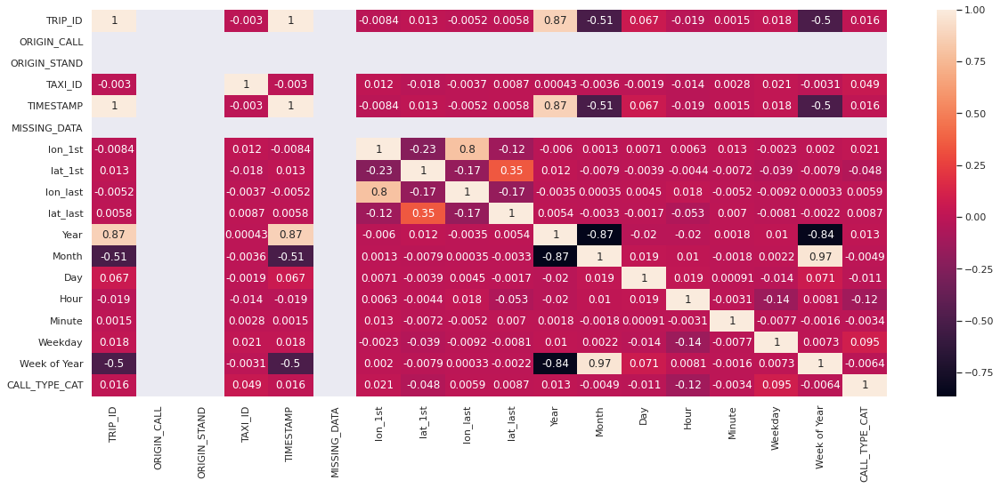

In [59]:
matrix_corr=train_df.corr()
sns.set(rc = {'figure.figsize':(20,8)})
sns.heatmap(matrix_corr, annot=True, )            

## Count Features

In [60]:
train_df["TRIP_ID"].nunique()

1704695

CALL_TYPE: (char) It identifies the way used to demand this service. It may contain one of three possible values:
‘A’ if this trip was dispatched from the central;
‘B’ if this trip was demanded directly to a taxi driver on a specific stand;
‘C’ otherwise (i.e. a trip demanded on a random street).

In [61]:
train_df['CALL_TYPE'].value_counts()

B    816058
C    524366
A    364345
Name: CALL_TYPE, dtype: int64

ORIGIN_CALL: (integer) It contains an unique identifier for each phone number which was used to demand, at least, one service. It identifies the trip’s customer if CALL_TYPE=’A’. Otherwise, it assumes a NULL value;

In [62]:
train_df["ORIGIN_CALL"].nunique()

1

In [63]:
train_df['ORIGIN_CALL'].value_counts()

1    1704769
Name: ORIGIN_CALL, dtype: int64

ORIGIN_STAND: (integer): It contains an unique identifier for the taxi stand. It identifies the starting point of the trip if CALL_TYPE=’B’. Otherwise, it assumes a NULL value;

In [64]:
train_df["ORIGIN_STAND"].nunique()

1

In [65]:
train_df['ORIGIN_STAND'].value_counts()

1    1704769
Name: ORIGIN_STAND, dtype: int64

In [66]:
train_df["TAXI_ID"].nunique()

444

In [67]:
train_df['TAXI_ID'].value_counts()

20000080    10512
20000403     9045
20000066     8432
20000364     7813
20000483     7711
            ...  
20000170       10
20000941        6
20000980        5
20000981        1
20000940        1
Name: TAXI_ID, Length: 444, dtype: int64

MISSING_DATA: (Boolean) It is FALSE when the GPS data stream is complete and TRUE whenever one (or more) locations are missing

In [68]:
train_df["MISSING_DATA"].nunique()

1

## Call type analysis


CALL_TYPE: (char) It identifies the way used to demand this service. It may contain one of three possible values:
‘A’ if this trip was dispatched from the central;
‘B’ if this trip was demanded directly to a taxi driver on a specific stand;
‘C’ otherwise (i.e. a trip demanded on a random street).

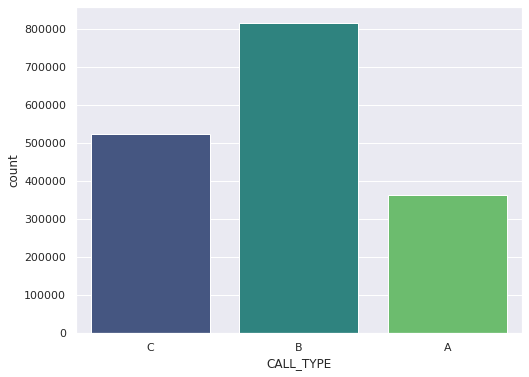

In [69]:
plt.figure(figsize=(8,6))
sns.countplot(x='CALL_TYPE',data=train_df,palette='viridis')

## Dates analysis

Identify any patterns in the data related to time

In [70]:
dayOfWeekHour = train_df.groupby(by=['Day of Week','Hour']).count()['TRIP_ID'].unstack()
dayOfWeekHour.head()

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day of Week,,,,,,,,,,,,,,,,,,,,,
Friday,6256,6284,6010,6829,7431,7045,7099,10290,14966,16049,...,15781,15369,15083,14037,13073,12471,12555,11248,10111,10089
Monday,4129,3080,2373,2742,3305,3519,5308,10433,16221,17253,...,14878,14672,13880,12799,11264,9327,8307,7006,6076,5373
Saturday,11287,12353,13192,14923,15035,13194,10781,8697,8880,9691,...,9628,9511,9210,9665,10016,10817,11756,11089,9927,10533
Sunday,12732,13881,15030,17074,17641,15641,11969,8238,6723,6871,...,7116,7572,7510,7859,8827,8503,8349,7357,6004,4710
Thursday,5421,5094,4405,4945,5410,5249,6155,10372,15170,16521,...,15376,14731,14127,13322,11823,10331,9130,8105,7298,6606


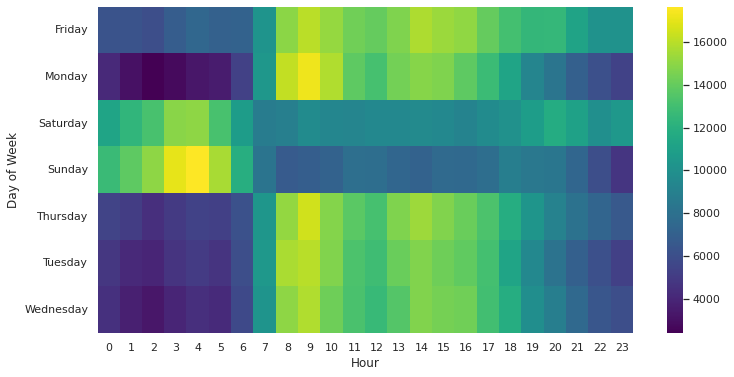

In [71]:
# from Udemy Machine learning course

plt.figure(figsize=(12,6))
sns.heatmap(dayOfWeekHour,cmap='viridis')

In [72]:
dayHour = train_df.groupby(by=['Day','Hour']).count()['TRIP_ID'].unstack()
dayHour.head()

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Day,,,,,,,,,,,,,,,,,,,,,
1,2229,2642,2757,2984,3032,2851,2646,2788,2954,2956,...,2695,2693,2509,2647,2379,2232,2146,2059,1727,1555
2,1473,1417,1467,1591,1690,1606,1928,2543,3265,3281,...,3206,3020,3061,2798,2612,2395,2173,1824,1642,1445
3,1474,1244,1126,1312,1427,1318,1398,2130,3137,3249,...,3059,3025,3036,2794,2499,2347,2199,2081,1770,1723
4,1757,1751,1724,1899,2072,1958,1933,2434,3246,3371,...,3236,3193,2943,2961,2700,2325,2204,1927,1773,1590
5,1664,1553,1406,1604,1699,1591,1508,2248,3086,3305,...,3100,2979,2904,2869,2656,2434,2246,2012,1873,1789


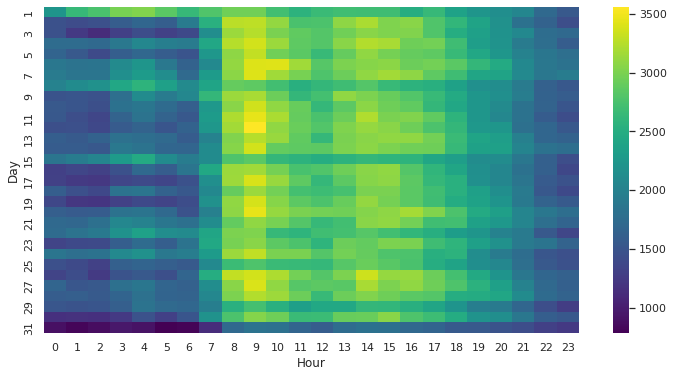

In [73]:
# from Udemy Machine learning course

plt.figure(figsize=(12,6))
sns.heatmap(dayHour,cmap='viridis')

In [74]:
dayMonth = train_df.groupby(by=['Day','Month']).count()['TRIP_ID'].unstack()
dayMonth.head()

Month,1,2,3,4,5,6,7,8,9,10,11,12
Day,,,,,,,,,,,,
1,7465.0,4584.0,5741.0,4467.0,4598.0,5462.0,4713.0,4388.0,3857.0,5240.0,6051.0,4568.0
2,4475.0,4337.0,4780.0,4235.0,5304.0,4715.0,4586.0,4538.0,4196.0,4984.0,5814.0,4198.0
3,4148.0,3980.0,4159.0,4811.0,5647.0,4777.0,4724.0,4500.0,3885.0,4374.0,4813.0,4177.0
4,4008.0,4701.0,5589.0,5696.0,6237.0,4620.0,5200.0,3799.0,4351.0,5945.0,4351.0,4382.0
5,3592.0,3829.0,4026.0,4608.0,5726.0,5837.0,5707.0,3721.0,4507.0,5746.0,4180.0,4414.0


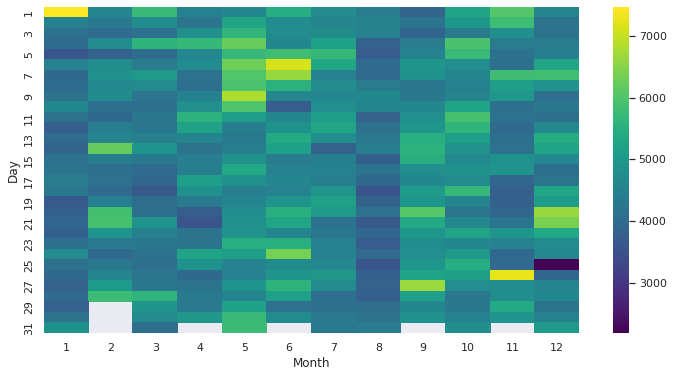

In [75]:
plt.figure(figsize=(12,6))
sns.heatmap(dayMonth,cmap='viridis')

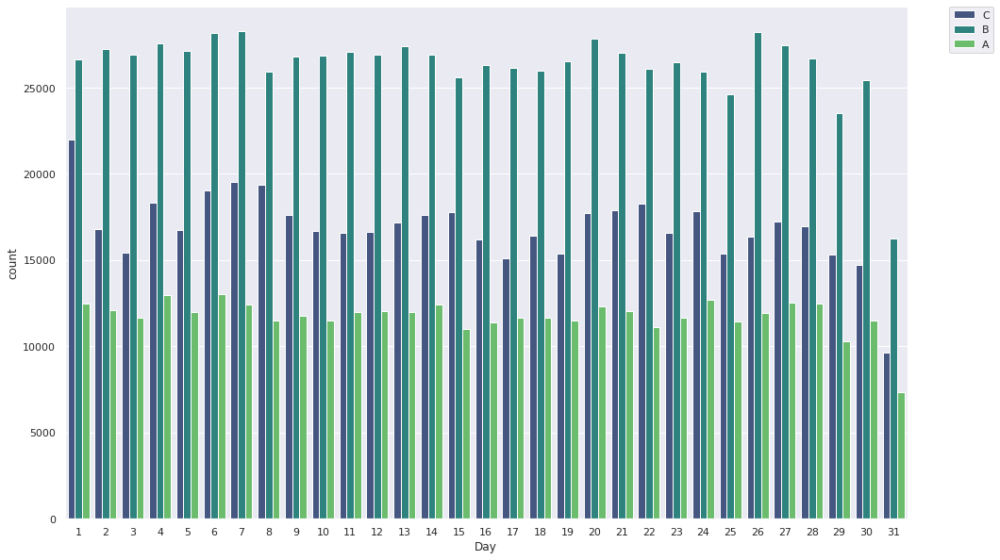

In [76]:
day_per_call_type_g = sns.countplot(x='Day',data=train_df,hue='CALL_TYPE',palette='viridis')

day_per_call_type_g = plt.gcf()
day_per_call_type_g.set_size_inches( 16, 10)

# To relocate the legend
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

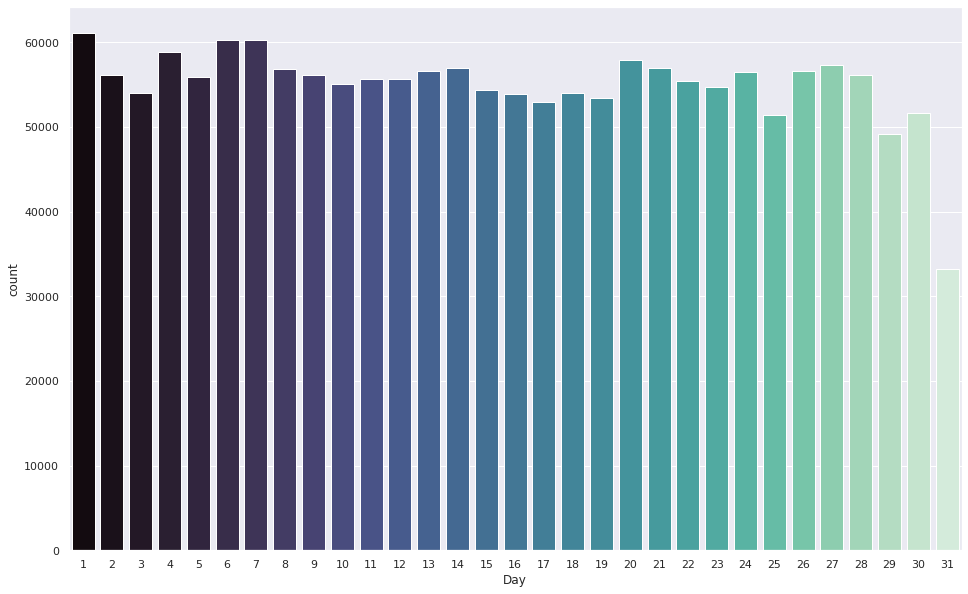

In [77]:
day_of_week_g = sns.countplot(x='Day',data=train_df,palette='mako')

day_of_week_g = plt.gcf()
day_of_week_g.set_size_inches( 16, 10)

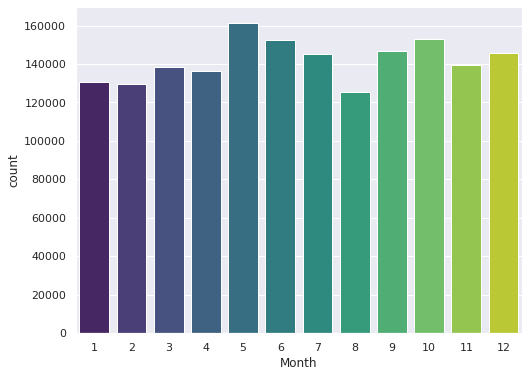

In [78]:
month_g = sns.countplot(x='Month',data=train_df,palette='viridis')

month_g = plt.gcf()
month_g.set_size_inches(8, 6)

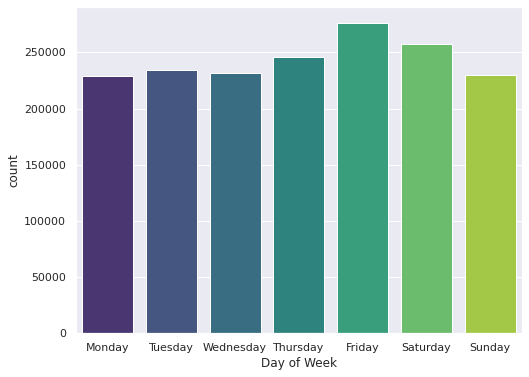

In [79]:
month_g = sns.countplot(x='Day of Week',data=train_df,palette='viridis')

month_g = plt.gcf()
month_g.set_size_inches(8, 6)

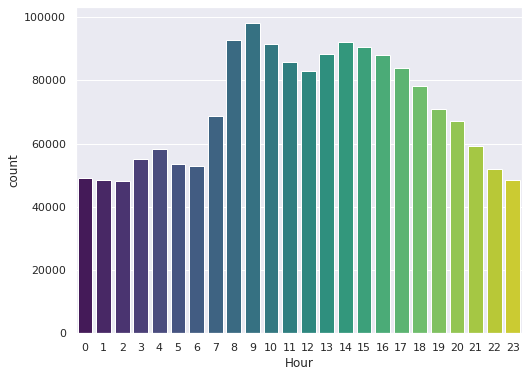

In [80]:
month_g = sns.countplot(x='Hour',data=train_df,palette='viridis')

month_g = plt.gcf()
month_g.set_size_inches(8, 6)

### Week of the year

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


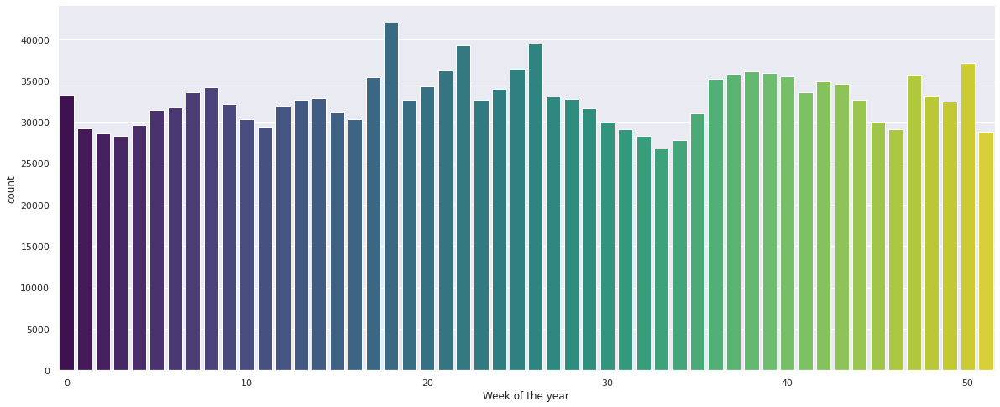

In [81]:
# change color
plt.figure()
sns.countplot(train_df['Week of Year'], palette='viridis')
plt.gca().xaxis.set_major_locator(MultipleLocator(10))
plt.gca().xaxis.set_major_formatter(FormatStrFormatter('%d'))
plt.xlabel('Week of the year')
plt.show()

### Trip duration

In [82]:
train_df['Duration'] = train_df['POLYLINE'].apply(lambda x: 15 * len(x.split(","))/2)
test_df['Duration'] = test_df['POLYLINE'].apply(lambda x: 15 * len(x.split(","))/2)

test_df.head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,lon_1st,...,formatted_timestamp,Year,Month,Day,Hour,Minute,Weekday,Day of Week,CALL_TYPE_CAT,Duration
0,T1,B,1,1,20000542,1.408039e+09,A,1,"[[-8.585676,41.148522],[-8.585712,41.148639],[...",-8.585676,...,2014-08-14 17:57:17+00:00,2014,8,14,17,57,3,Thursday,2,165.0
1,T2,B,1,1,20000108,1.408039e+09,A,1,"[[-8.610876,41.14557],[-8.610858,41.145579],[-...",-8.610876,...,2014-08-14 17:50:11+00:00,2014,8,14,17,50,3,Thursday,2,600.0
2,T3,B,1,1,20000370,1.408039e+09,A,1,"[[-8.585739,41.148558],[-8.58573,41.148828],[-...",-8.585739,...,2014-08-14 17:49:28+00:00,2014,8,14,17,49,3,Thursday,2,600.0
3,T4,B,1,1,20000492,1.408039e+09,A,1,"[[-8.613963,41.141169],[-8.614125,41.141124],[...",-8.613963,...,2014-08-14 17:58:10+00:00,2014,8,14,17,58,3,Thursday,2,120.0
4,T5,B,1,1,20000621,1.408039e+09,A,1,"[[-8.619903,41.148036],[-8.619894,41.148036]]",-8.619903,...,2014-08-14 17:59:37+00:00,2014,8,14,17,59,3,Thursday,2,30.0


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/usr/local/lib/python3.7/dist-packages/pandas/io/formats/format.py:1429: FutureWarning: Index.ravel returning ndarray is deprecated; in a future version this will return a view on self.
  for val, m in zip(values.ravel(), mask.ravel())


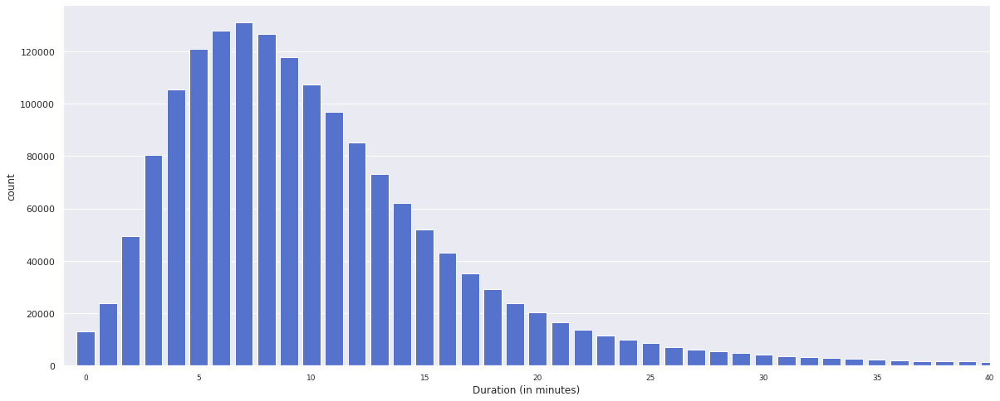

In [83]:
# get distribution of trips
plt.figure()
bins = np.arange(60, train_df['Duration'].max(), 60)
binned = pd.cut(train_df['Duration'], bins, labels=bins[:-1]/60)
sns.countplot(binned, color='royalblue')
plt.gca().xaxis.set_major_locator(MultipleLocator(5))
plt.gca().xaxis.set_major_formatter(FormatStrFormatter('%d'))
plt.xlim(-1, 40)
plt.xticks(fontsize=9)
plt.xlabel('Duration (in minutes)')
plt.show()

### Taxi ID analysis

In [84]:
train_df['TAXI_ID'].value_counts(ascending=True)

20000940        1
20000981        1
20000980        5
20000941        6
20000170       10
            ...  
20000483     7711
20000364     7813
20000066     8432
20000403     9045
20000080    10512
Name: TAXI_ID, Length: 444, dtype: int64

## Location analysis

### Heatmap

Heat map of all the origins and destinations

In [85]:
map_rob = folium.Map(location=[41.141412,-8.590324], zoom_start=10, tiles='Stamen Terrain')


mapping_1st = pd.DataFrame({
    "date":train_df.head(5000)["formatted_timestamp"].values,
    "lat":train_df.head(5000)["lat_1st"].values,
    "lon":train_df.head(5000)["lon_1st"].values,
})

heat_data_1 = [[row['lat'],row[ 'lon']] for index, row in mapping_1st.iterrows()]

mapping_lst = pd.DataFrame({
    "date":train_df.head(5000)["formatted_timestamp"].values,
    "lat":train_df.head(5000)["lat_last"].values,
    "lon":train_df.head(5000)["lon_last"].values,
})

heat_data_2 = [[row['lat'],row[ 'lon']] for index, row in mapping_lst.iterrows()]

heat_data = heat_data_1 + heat_data_2

# Plot it on the map
HeatMap(heat_data).add_to(map_rob)

# Display the map
map_rob


### Create a map for visualizing the origins

In [86]:
%%time
# Visualization, sampling 5000 datas.
mapping_1st = pd.DataFrame({
    "date":train_df.head(5000)["formatted_timestamp"].values,
    "lat":train_df.head(5000)["lat_1st"].values,
    "lon":train_df.head(5000)["lon_1st"].values
})

por_map = folium.Map(location=[41.141412,-8.590324], tiles='Stamen Terrain', zoom_start=11)

# source
for i, r in mapping_1st.iterrows():
    folium.CircleMarker(location=[r["lat"],r["lon"]], radius=6, color="red", fill=True, opacity=0.6).add_to(por_map)

CPU times: user 1.4 s, sys: 73.4 ms, total: 1.47 s
Wall time: 1.37 s


In [87]:
por_map

Create a map for visualizing the destinations

In [88]:
%%time
# Visualization, sampling 5000 datas.
mapping_last = pd.DataFrame({
    "date":train_df.head(5000)["formatted_timestamp"].values,
    "lat":train_df.head(5000)["lat_last"].values,
    "lon":train_df.head(5000)["lon_last"].values
})

por_map = folium.Map(location=[41.141412,-8.590324], tiles='Stamen Terrain', zoom_start=11)

# destination
for i, r in mapping_last.iterrows():
   folium.CircleMarker(location=[r["lat"],r["lon"]], radius=6, color="blue", fill=True, opacity=0.6).add_to(por_map)   
  

CPU times: user 1.43 s, sys: 55.3 ms, total: 1.48 s
Wall time: 1.46 s


In [89]:
por_map

### Find min and max longitude and latitude

In [39]:
print("this is the smallest lon_1st", min(train_df["lon_1st"]))
print("this is the smallest lat_1st", min(train_df["lat_1st"]))
print("this is the largest lon_last", max(train_df["lon_last"]))
print("this is the largest lat_last", max(train_df["lat_last"]))
print("this is the average lon_last", statistics.mean(train_df["lon_last"]))
print("this is the average lat_last", statistics.mean(train_df["lat_last"]))

this is the smallest lon_1st -36.913779
this is the smallest lat_1st 31.992111
this is the largest lon_last 52.900803
this is the largest lat_last 47.397816
this is the average lon_last -8.620059130381302
this is the average lat_last 41.16232642319751


### Removing outliers

Remove outliers that are above or below by three standard deviations
Source:https://www.analyticsvidhya.com/blog/2021/05/feature-engineering-how-to-detect-and-remove-outliers-with-python-code/

This is in the exploratory data analysis so that we can check the data before removing the outliers.

In [40]:
# find the boundary values
print("Highest allowed lon_last",train_df['lon_last'].mean() + 3*train_df['lon_last'].std())
print("Lowest allowed lon_last",train_df['lon_last'].mean() - 3*train_df['lon_last'].std())
print("Highest allowed lat_last",train_df['lat_last'].mean() + 3*train_df['lat_last'].std())
print("Lowest allowed lat_last",train_df['lat_last'].mean() - 3*train_df['lat_last'].std())

Highest allowed lon_last -8.421708742710695
Lowest allowed lon_last -8.8184095180519
Highest allowed lat_last 41.27569726818719
Lowest allowed lat_last 41.048955578207824


In [41]:
# find outliers
train_df[(train_df['lon_last'] > -8.421708742710695) | (train_df['lon_last'] < -8.8184095180519)].head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,lon_1st,...,formatted_timestamp,Year,Month,Day,Hour,Minute,Weekday,Week of Year,Day of Week,CALL_TYPE_CAT
2085,1372672472620000539,C,1,1,20000539,1.372672e+09,A,1,"[[-8.634438,41.152554],[-8.634456,41.152167],[...",-8.634438,...,2013-07-01 09:54:32+00:00,2013,7,1,9,54,0,26,Monday,3
3087,1372687204620000406,B,1,1,20000406,1.372687e+09,A,1,"[[-8.582616,41.180229],[-8.582355,41.180247],[...",-8.582616,...,2013-07-01 14:00:04+00:00,2013,7,1,14,0,0,26,Monday,2
4216,1372707067620000022,B,1,1,20000022,1.372707e+09,A,1,"[[-8.600166,41.182704],[-8.60022,41.182803],[-...",-8.600166,...,2013-07-01 19:31:07+00:00,2013,7,1,19,31,0,26,Monday,2
4404,1372709186620000136,B,1,1,20000136,1.372709e+09,A,1,"[[-8.585631,41.148603],[-8.585676,41.148819],[...",-8.585631,...,2013-07-01 20:06:26+00:00,2013,7,1,20,6,0,26,Monday,2
5279,1372715001620000453,B,1,1,20000453,1.372715e+09,A,1,"[[-8.599257,41.149143],[-8.59878,41.149143],[-...",-8.599257,...,2013-07-01 21:43:21+00:00,2013,7,1,21,43,0,26,Monday,2


In [42]:
train_df[(train_df['lat_last'] > 41.27569726818719) | (train_df['lat_last'] < 41.048955578207824)].head()

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,lon_1st,...,formatted_timestamp,Year,Month,Day,Hour,Minute,Weekday,Week of Year,Day of Week,CALL_TYPE_CAT
955,1372664544620000596,A,1,1,20000596,1.372665e+09,A,1,"[[-8.644077,41.158845],[-8.644023,41.158926],[...",-8.644077,...,2013-07-01 07:42:24+00:00,2013,7,1,7,42,0,26,Monday,1
1127,1372664514620000651,B,1,1,20000651,1.372665e+09,A,1,"[[-8.602893,41.179644],[-8.602911,41.179644],[...",-8.602893,...,2013-07-01 07:41:54+00:00,2013,7,1,7,41,0,26,Monday,2
1201,1372663983620000539,A,1,1,20000539,1.372664e+09,A,1,"[[-8.608905,41.144274],[-8.608887,41.144301],[...",-8.608905,...,2013-07-01 07:33:03+00:00,2013,7,1,7,33,0,26,Monday,1
1261,1372665698620000131,C,1,1,20000131,1.372666e+09,A,1,"[[-8.601156,41.135751],[-8.600679,41.136165],[...",-8.601156,...,2013-07-01 08:01:38+00:00,2013,7,1,8,1,0,26,Monday,3
1321,1372669549620000397,B,1,1,20000397,1.372670e+09,A,1,"[[-8.585622,41.148936],[-8.585784,41.148981],[...",-8.585622,...,2013-07-01 09:05:49+00:00,2013,7,1,9,5,0,26,Monday,2


In [43]:
print("Highest allowed lon_1st",train_df['lon_1st'].mean() + 3*train_df['lon_1st'].std())
print("Lowest allowed lon_1st",train_df['lon_1st'].mean() - 3*train_df['lon_1st'].std())
print("Highest allowed lat_1st",train_df['lat_1st'].mean() + 3*train_df['lat_1st'].std())
print("Lowest allowed lat_1st",train_df['lat_1st'].mean() - 3*train_df['lat_1st'].std())

Highest allowed lon_1st -8.434195458508206
Lowest allowed lon_1st -8.800317973533318
Highest allowed lat_1st 41.22893021487443
Lowest allowed lat_1st 41.08524952246946


In [45]:
train_df = train_df[(train_df['lon_last'] < -8.421708742710695) & (train_df['lon_last'] > -8.8184095180519) & 
                      (train_df['lat_last'] < 41.27569726818719) & (train_df['lat_last'] > 41.048955578207824) 
                      ]
len(train_df)

1694897

In [46]:
train_df = train_df[(train_df['lon_1st'] < -8.434195458508206) & (train_df['lon_1st'] > -8.800317973533318) & 
                      (train_df['lat_1st'] < 41.22893021487443) & (train_df['lat_1st'] > 41.08524952246946)
                      ]
len(train_df)

1688738

In [47]:
print("this is the smallest lon_1st", min(train_df["lon_1st"]))
print("this is the smallest lat_1st", min(train_df["lat_1st"]))
print("this is the largest lon_last", max(train_df["lon_last"]))
print("this is the largest lat_last", max(train_df["lat_last"]))
print("this is the average lon_last", statistics.mean(train_df["lon_last"]))
print("this is the average lat_last", statistics.mean(train_df["lat_last"]))

this is the smallest lon_1st -8.715051
this is the smallest lat_1st 41.085261
this is the largest lon_last -8.422812
this is the largest lat_last 41.275638
this is the average lon_last -8.620600157163516
this is the average lat_last 41.16228053056898


# IV. Feature Engineering for destination prediction

Add haversine distance as a feature

In [48]:
def haversine(lon_1st, lat_1st, lon_last, lat_last):

    lon_1st, lat_1st, lon_last, lat_last = map(np.radians, [lon_1st, lat_1st, lon_last, lat_last])

    dlon = lon_last - lon_1st
    dlat = lat_last - lat_1st

    a = np.sin(dlat/2.0)**2 + np.cos(lat_1st) * np.cos(lat_last) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    km = 6367 * c
    miles = km *  0.621371
    return miles

Add the distance to the training and test dataset

In [49]:
train_df['distance'] = haversine(train_df.lon_1st, train_df.lat_1st,
                                           train_df.lon_last, train_df.lat_last)
train_df['distance']

0          1.103364
1          1.540256
2          0.156762
3          1.841332
4          2.151444
             ...   
1710663    0.062134
1710665    1.726755
1710666    1.529699
1710668    2.610261
1710669    0.696895
Name: distance, Length: 1688738, dtype: float64

In [50]:
test_df['distance'] = haversine(test_df.lon_1st, test_df.lat_1st, test_df.lon_last, test_df.lat_last)
test_df['distance']

0      0.137440
1      1.329474
2      1.438002
3      0.037448
4      0.000468
         ...   
315    1.335245
316    1.143860
317    0.278379
318    0.808397
319    1.243989
Name: distance, Length: 320, dtype: float64

# V. Machine Learning Models

Source: https://www.kaggle.com/code/dahouda/taxi-trajectory-prediction-i

In [393]:
train_ml_df = train_df.copy()

In [394]:
train_ml_df = train_ml_df.sample(5000)

In [395]:
X = train_ml_df[["CALL_TYPE_CAT", 'ORIGIN_CALL', 'ORIGIN_STAND', 'MISSING_DATA', 'lon_1st', 'lat_1st', 'distance']]

In [396]:
y = train_ml_df[["lon_last","lat_last"]]

In [397]:
test_ml_df = test_df.copy()

In [398]:
X_Test = test_ml_df[["CALL_TYPE_CAT", 'ORIGIN_CALL', 'ORIGIN_STAND', 'MISSING_DATA', 'lon_1st', 'lat_1st', 'distance']]

In [399]:
# train test split
%%time
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

CPU times: user 2.89 ms, sys: 821 µs, total: 3.71 ms
Wall time: 3.75 ms


### 5.1 Random Forest Regressor

In [400]:
%%time
forest = MultiOutputRegressor(RandomForestRegressor(n_estimators=10, random_state=1))

# Fitting
forest = forest.fit(X_train, y_train)
y_train_pred = forest.predict(X_train)
y_test_pred = forest.predict(X_test)

# Make predictions on test data using the model trained on original data

# Performance metrics

print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred)))
print("Mean Square Error on testting Data:{}".format(mean_squared_error(y_test, y_test_pred)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred)))

Mean Square Error on training Data:9.738098313778366e-05
Mean Square Error on testting Data:0.0005349831965136865
R2 score train:0.8762256522550829
R2 score test:0.34428360381001255
CPU times: user 330 ms, sys: 3.93 ms, total: 333 ms
Wall time: 334 ms


In [401]:
y_Test_pred = forest.predict(X_Test)

In [402]:
# value is almost the same so its good
y_test[0:1]

,lon_last,lat_last
1182094,-8.585739,41.148801


In [403]:
forest.predict(X_test[0:1])

array([[-8.5911075, 41.1495048]])

### 5.2 Gradient Boosting Regressor

In [505]:
%%time
boosting = MultiOutputRegressor(GradientBoostingRegressor(random_state=0))

# Fitting
boosting = boosting.fit(X_train, y_train)
y_train_pred2 = boosting.predict(X_train)
y_test_pred2 = boosting.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred2)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred2)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred2)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred2)))

Mean Square Error on training Data:0.00013770721435491038
Mean Square Error on testing Data:0.00028032708801917195
R2 score train:0.8051110850717558
R2 score test:0.6722583565251119
CPU times: user 924 ms, sys: 5.61 ms, total: 930 ms
Wall time: 930 ms


In [506]:
y_Test_pred2 = boosting.predict(X_Test)

### 5.3 k-Nearest Neighbors for Multioutput Regression

In [507]:
%%time
knn = MultiOutputRegressor(KNeighborsRegressor())

# Fitting
knn = knn.fit(X_train, y_train)
y_train_pred3 = knn.predict(X_train)
y_test_pred3 = knn.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred3)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred3)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred3)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred3)))

Mean Square Error on training Data:0.00016275427406573095
Mean Square Error on testing Data:0.0003379019975567979
R2 score train:0.7751278197581064
R2 score test:0.6004041100794759
CPU times: user 111 ms, sys: 1.94 ms, total: 113 ms
Wall time: 115 ms


In [508]:
%%time
y_Test_pred3 = knn.predict(X_Test)

CPU times: user 17.5 ms, sys: 45 µs, total: 17.6 ms
Wall time: 18.8 ms


### 5.4 Decision Tree for Multioutput Regression

In [423]:
%%time
dt = MultiOutputRegressor(DecisionTreeRegressor(max_depth=50, random_state=1))

# Fitting
dt = dt.fit(X_train, y_train)
y_train_pred4 = dt.predict(X_train)
y_test_pred4 = dt.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred4)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred4)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred4)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred4)))


Mean Square Error on training Data:0.0
Mean Square Error on testing Data:0.0009046016533529981
R2 score train:1.0
R2 score test:-0.12776400658890008
CPU times: user 96.9 ms, sys: 2.02 ms, total: 99 ms
Wall time: 109 ms


lowest mean square error = boosting

In [424]:
y_Test_pred4 = boosting.predict(X_Test)

### 5.5 HistGradientBoostingRegressor

In [410]:
# explicitly require this experimental feature
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor

In [411]:
%%time
histboosting = MultiOutputRegressor(HistGradientBoostingRegressor())

# Fitting
histboosting = histboosting.fit(X_train, y_train)
y_train_pred5 = histboosting.predict(X_train)
y_test_pred5 = histboosting.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred5)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred5)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred5)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred5)))

Mean Square Error on training Data:0.0002633416143822989
Mean Square Error on testing Data:0.0005092732496351739
R2 score train:0.6683734645856784
R2 score test:0.3743566798266047
CPU times: user 1.76 s, sys: 57.2 ms, total: 1.82 s
Wall time: 986 ms


# VI. Submission

## 6.1 Random Forest Regressor

In [413]:
%%time
submission_lat1 = y_Test_pred.T[1]
submission_lon1 = y_Test_pred.T[0]

CPU times: user 17 µs, sys: 3 µs, total: 20 µs
Wall time: 24.6 µs


In [414]:
%%time
submission1 = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat1, "LONGITUDE":submission_lon1})

CPU times: user 3.05 ms, sys: 4 µs, total: 3.05 ms
Wall time: 3.18 ms


In [415]:
submission1.to_csv('submission1.csv', index=False)
sub = pd.read_csv("./submission1.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.148441,-8.587736
1,T2,41.154869,-8.624775
2,T3,41.156768,-8.600846
3,T4,41.140798,-8.617573
4,T5,41.148791,-8.616412


## 6.2 Gradient Boosting Regressor

In [ ]:
%%time
submission_lat2 = y_Test_pred2.T[1]
submission_lon2 = y_Test_pred2.T[0]

In [417]:
%%time
submission2 = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat2, "LONGITUDE":submission_lon2})

CPU times: user 1.17 ms, sys: 18 µs, total: 1.19 ms
Wall time: 1.2 ms


In [501]:
submission2.to_csv('submission2.csv', index=False)
sub = pd.read_csv("./submission2.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.151456,-8.594181
1,T2,41.153299,-8.613552
2,T3,41.154729,-8.603160
3,T4,41.146317,-8.613615
4,T5,41.152888,-8.615946


## 6.3 k-Nearest Neighbors Regression

In [418]:
%%time
submission_lat3 = y_Test_pred3.T[1]
submission_lon3 = y_Test_pred3.T[0]

CPU times: user 16 µs, sys: 3 µs, total: 19 µs
Wall time: 24.1 µs


In [419]:
%%time
submission3 = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat3, "LONGITUDE":submission_lon3})

CPU times: user 1.09 ms, sys: 0 ns, total: 1.09 ms
Wall time: 1.11 ms


In [420]:
submission3.to_csv('submission3.csv', index=False)
sub = pd.read_csv("./submission3.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.147446,-8.609953
1,T2,41.148310,-8.603966
2,T3,41.159896,-8.611240
3,T4,41.151926,-8.613684
4,T5,41.144621,-8.615664


## 6.4 Decision Trees Regression

In [428]:
%%time
submission_lat4 = y_Test_pred4.T[1]
submission_lon4 = y_Test_pred4.T[0]

CPU times: user 19 µs, sys: 3 µs, total: 22 µs
Wall time: 26.2 µs


In [429]:
%%time
submission4 = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat4, "LONGITUDE":submission_lon4})

CPU times: user 3.6 ms, sys: 0 ns, total: 3.6 ms
Wall time: 8.13 ms


In [430]:
submission4.to_csv('submission4.csv', index=False)
sub = pd.read_csv("./submission4.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.151456,-8.594181
1,T2,41.153299,-8.613552
2,T3,41.154729,-8.603160
3,T4,41.146317,-8.613615
4,T5,41.152888,-8.615946


## 6.5 HistGradient Boosting Regressor

In [431]:
%%time
submission_lat5 = y_Test_pred5.T[1]
submission_lon5 = y_Test_pred5.T[0]

CPU times: user 19 µs, sys: 0 ns, total: 19 µs
Wall time: 24.1 µs


In [432]:
%%time
submission5 = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat5, "LONGITUDE":submission_lon5})

CPU times: user 797 µs, sys: 8 µs, total: 805 µs
Wall time: 739 µs


In [433]:
submission5.to_csv('submission5.csv', index=False)
sub = pd.read_csv("./submission5.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.151456,-8.594181
1,T2,41.153299,-8.613552
2,T3,41.154729,-8.603160
3,T4,41.146317,-8.613615
4,T5,41.152888,-8.615946


# Basic Approach with Points of Interest Data

This section starts with the basic approach with the points of interest data. 

Source: https://www.kaggle.com/code/raisssaid/semi-supervised-learning-clustering-geo-data

# I. Import Packages

In [535]:
pip install kneed

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [536]:
from sklearn.cluster import KMeans
from kneed import KneeLocator
from sklearn.metrics import silhouette_score

# II. Clustering the data

## Cluster the POI data

In [537]:
points_of_interest_df = pd.read_excel('pointsofinterest.xlsx')

/usr/local/lib/python3.7/dist-packages/openpyxl/worksheet/_reader.py:312: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


In [538]:
features = points_of_interest_df[['latitude', 'longitude']]
X = np.array(features)

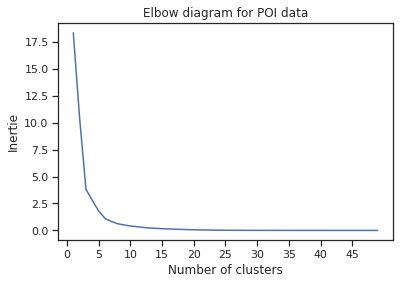

In [539]:
# Choose the best number of clusters using Elbow method
inertia = []
for i in range(1, 50):
  kmeans = KMeans(n_clusters=i, random_state=0).fit(X)
  inertia.append(kmeans.inertia_)
plt.plot(range(1, 50), inertia)
plt.title('Elbow diagram for POI data')
plt.xlabel('Number of clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(0, 50, 5))
plt.show()

In [540]:
knee_point = KneeLocator(
    range(1, 50),
    inertia,
    curve = 'convex',
    direction = 'decreasing'
)
print(knee_point.knee)

6


In [541]:
kmeans = KMeans(n_clusters=6, random_state=0).fit(X)
inertia_ = kmeans.inertia_
silhouette_ = silhouette_score(X, kmeans.labels_)
print("This model with 6 cluster is characterized by :")
# Iinertia is sum of squared distances of samples to their closest cluster center.
print("Iinertia : {:.3f}".format(inertia_))
print("Silhouette mean score : {:.3f}".format(silhouette_))

This model with 6 cluster is characterized by :
Iinertia : 1.109
Silhouette mean score : 0.705


In [542]:
points_of_interest_df['Cluster_KMeans'] = kmeans.labels_

In [543]:
poi_clusters = kmeans.cluster_centers_

In [544]:
poi_clusters_df = pd.DataFrame(poi_clusters, columns = ['poi_cluster_lat', 'poi_cluster_lon'])

In [545]:
poi_clusters_df

,poi_cluster_lat,poi_cluster_lon
0,41.132196,-8.622644
1,40.712714,-7.887632
2,40.630532,-8.687014
3,40.280075,-8.454206
4,41.076736,-7.569003
5,41.597632,-8.459957


In [546]:
import folium
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray', 'red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple','pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray' ]
lat = points_of_interest_df.iloc[0]['latitude']
lng = points_of_interest_df.iloc[0]['longitude']
map = folium.Map(location=[41.1400, -8.6094], zoom_start=12)
for _, row in points_of_interest_df.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=5, 
        tooltip = row["name"] + ', ' + row["categories"] + ' (' + str(row["Cluster_KMeans"]) + ')',
        weight=2, 
        fill=True, 
        fill_color=colors[int(row["Cluster_KMeans"])],
        color=colors[int(row["Cluster_KMeans"])]
    ).add_to(map)
map

## Cluster the Taxi Mobility data

### Cluster in training set

In [547]:
train_kmeans_df = train_df.copy()

In [548]:
train_kmeans_df = train_kmeans_df.sample(160000)

In [549]:
features = train_kmeans_df[['lat_last', 'lon_last']]
X_1 = np.array(features)

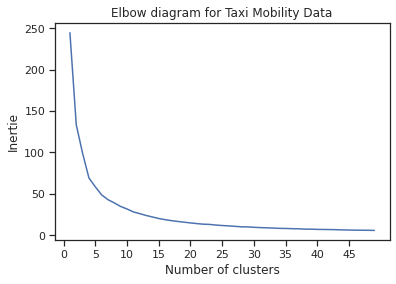

In [550]:
# Choose the best number of clusters using Elbow method
inertia = []
for i in range(1, 50):
  kmeans = KMeans(n_clusters=i,max_iter=10,random_state=0).fit(X_1)
  inertia.append(kmeans.inertia_)
plt.plot(range(1, 50), inertia)
plt.title('Elbow diagram for Taxi Mobility Data')
plt.xlabel('Number of clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(0, 50, 5))
plt.show()

In [551]:
knee_point = KneeLocator(
    range(1, 50),
    inertia,
    curve = 'convex',
    direction = 'decreasing'
)
print(knee_point.knee)

7


In [552]:
kmeans = KMeans(n_clusters=7, random_state=0).fit(X_1)
inertia_ = kmeans.inertia_
silhouette_ = silhouette_score(X_1, kmeans.labels_)
print("This model with 7 cluster is characterized by :")
# Iinertia is sum of squared distances of samples to their closest cluster center.
print("Iinertia : {:.3f}".format(inertia_))
print("Silhouette mean score : {:.3f}".format(silhouette_))

This model with 7 cluster is characterized by :
Iinertia : 42.893
Silhouette mean score : 0.392


In [553]:
train_kmeans_df['Cluster_KMeans'] = kmeans.labels_

In [554]:
train_clusters = kmeans.cluster_centers_

In [555]:
train_clusters 

array([[41.16922091, -8.67075842],
       [41.15938018, -8.58539028],
       [41.15812016, -8.63826244],
       [41.23514205, -8.66468117],
       [41.14461567, -8.61148926],
       [41.17777103, -8.54890846],
       [41.173837  , -8.61065521]])

In [556]:
train_clusters_df = pd.DataFrame(train_clusters, columns = ['train_cluster_lat', 'train_cluster_lon'])

In [557]:
import folium
colors = ['red', 'blue', 'green', 'purple', 'darkblue', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray', 'red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple','pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray' ]
lat_1 = train_kmeans_df.iloc[0]['lat_last']
lng_1 = train_kmeans_df.iloc[0]['lon_last']
map_1 = folium.Map(location=[41.1400, -8.6094], zoom_start=12)
for _, row in train_kmeans_df[:100].iterrows():
    folium.CircleMarker(
        location=[row["lat_last"], row["lon_last"]],
        radius=7, 
        tooltip = str(row["TRIP_ID"]) + ', ' + str(row["Cluster_KMeans"]) + ')',
        weight=3, 
        fill=True, 
        fill_color=colors[int(row["Cluster_KMeans"])],
        color=colors[int(row["Cluster_KMeans"])]
    ).add_to(map_1)
map_1

In [558]:
def haversine(lon_1st, lat_1st, lon_last, lat_last):

    lon_1st, lat_1st, lon_last, lat_last = map(np.radians, [lon_1st, lat_1st, lon_last, lat_last])

    dlon = lon_last - lon_1st
    dlat = lat_last - lat_1st

    a = np.sin(dlat/2.0)**2 + np.cos(lat_1st) * np.cos(lat_last) * np.sin(dlon/2.0)**2

    c = 2 * np.arcsin(np.sqrt(a))
    km = 6367 * c
    miles = km *  0.621371
    return miles

In [559]:
import math
from math import sin, cos, sqrt, atan2, radians

In [560]:
def haversine2(lon1, lat1, lon2, lat2):
    R = 6370

    dlon = lon2 - lon1
    dlat = lat2- lat1

    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    distance = R * c
    return distance

In [561]:
cluster_assignments = []
distances = []

for index_t,row_t in train_clusters_df.iterrows():
  distances = []
  for index_poi,row_poi in poi_clusters_df.iterrows():
    distance_between_clusters = haversine2(row_poi['poi_cluster_lon'], row_poi['poi_cluster_lat'], row_t['train_cluster_lon'], row_t['train_cluster_lat'])
    distances.append(distance_between_clusters)
  cluster_assignments.append(distances)

In [562]:
lowest_distance = []
for i in cluster_assignments:
  min_value = min(i)
  print(min_value)
  min_index=i.index(min_value)
  print(min_index)
  lowest_distance.append(min_index)

375.2393721631288
0
284.97973204932526
0
190.46891967051002
0
702.5289963784381
0
104.27415514995587
0
532.6889349732468
0
275.0262778428843
0


In [563]:
print(lowest_distance)

[0, 0, 0, 0, 0, 0, 0]


In [564]:
map_call_poi = {0:0, 1:4, 2:2, 3:0, 4:4}
train_kmeans_df["Cluster_KMeans_POI"] = train_kmeans_df["Cluster_KMeans"].map(map_call_poi)

In [565]:
train_kmeans_df['Cluster_KMeans_POI'].value_counts()

4.0    71562
2.0    32367
0.0    27705
Name: Cluster_KMeans_POI, dtype: int64

In [566]:
train_kmeans_df

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,lon_1st,...,Day,Hour,Minute,Weekday,Week of Year,Day of Week,CALL_TYPE_CAT,distance,Cluster_KMeans,Cluster_KMeans_POI
1460836,1399888493620000233,C,1,1,20000233,1.399888e+09,A,1,"[[-8.606502,41.144589],[-8.606763,41.144688],[...",-8.606502,...,12,9,54,0,19,Monday,3,1.808242,6,NaN
1481553,1400267210620000031,B,1,1,20000031,1.400267e+09,A,1,"[[-8.628327,41.157531],[-8.627175,41.157585],[...",-8.628327,...,16,19,6,4,19,Friday,2,1.212054,4,4.0
163624,1375691391620000900,B,1,1,20000900,1.375691e+09,A,1,"[[-8.606637,41.14467],[-8.6067,41.144706],[-8....",-8.606637,...,5,8,29,0,31,Monday,2,0.815492,4,4.0
75519,1373987643620000243,C,1,1,20000243,1.373988e+09,A,1,"[[-8.666496,41.125617],[-8.666496,41.125617],[...",-8.666496,...,16,15,14,1,28,Tuesday,3,7.593132,3,0.0
806048,1387558966620000157,B,1,1,20000157,1.387559e+09,A,1,"[[-8.632269,41.164452],[-8.632278,41.164416],[...",-8.632269,...,20,17,2,4,50,Friday,2,1.198949,6,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558784,1383013673620000598,C,1,1,20000598,1.383014e+09,A,1,"[[-8.655066,41.15295],[-8.654778,41.152311],[-...",-8.655066,...,29,2,27,1,43,Tuesday,3,0.032393,2,2.0
1693477,1403868272620000625,A,1,1,20000625,1.403868e+09,A,1,"[[-8.624808,41.151654],[-8.624808,41.151654],[...",-8.624808,...,27,11,24,4,25,Friday,1,0.233529,4,4.0
1380666,1398623446620000508,C,1,1,20000508,1.398623e+09,A,1,"[[-8.596431,41.14683],[-8.597106,41.147262],[-...",-8.596431,...,27,18,30,6,16,Sunday,3,2.562825,5,NaN
1103154,1393358303620000549,C,1,1,20000549,1.393358e+09,A,1,"[[-8.608761,41.147793],[-8.608599,41.147766],[...",-8.608761,...,25,19,58,1,8,Tuesday,3,3.509587,0,0.0


In [567]:
train_kmeans_df.fillna(value = 8,inplace = True)

In [568]:
train_kmeans_df['Cluster_KMeans_POI'].value_counts()

4.0    71562
2.0    32367
8.0    28366
0.0    27705
Name: Cluster_KMeans_POI, dtype: int64

In [569]:
import folium
colors = ['red', 'blue', 'green', 'orange', 'darkblue', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray', 'red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple','pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray' ]
lat_1 = train_kmeans_df.iloc[0]['lat_last']
lng_1 = train_kmeans_df.iloc[0]['lon_last']
map_1 = folium.Map(location=[41.1400, -8.6094], zoom_start=12)
for _, row in train_kmeans_df[:5000].iterrows():
    folium.CircleMarker(
        location=[row["lat_last"], row["lon_last"]],
        radius=7, 
        tooltip = str(row["TRIP_ID"]) + ', ' + str(row["Cluster_KMeans_POI"]) + ')',
        weight=3, 
        fill=True, 
        fill_color=colors[int(row["Cluster_KMeans_POI"])],
        color=colors[int(row["Cluster_KMeans_POI"])]
    ).add_to(map_1)
map_1

## Cluster in test set

In [570]:
test_kmeans_df = test_df.copy()

In [571]:
features = test_kmeans_df[['lat_last', 'lon_last']]
X_2 = np.array(features)

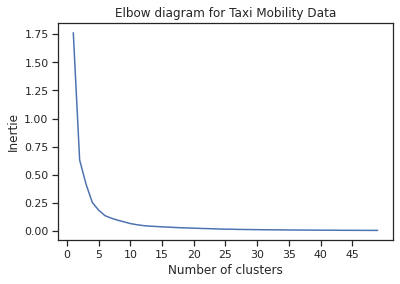

In [572]:
# Choose the best number of clusters using Elbow method
inertia = []
for i in range(1, 50):
  kmeans = KMeans(n_clusters=i,max_iter=10,random_state=0).fit(X_2)
  inertia.append(kmeans.inertia_)
plt.plot(range(1, 50), inertia)
plt.title('Elbow diagram for Taxi Mobility Data')
plt.xlabel('Number of clusters')
plt.ylabel('Inertie')
plt.xticks(np.arange(0, 50, 5))
plt.show()

In [573]:
knee_point = KneeLocator(
    range(1, 50),
    inertia,
    curve = 'convex',
    direction = 'decreasing'
)
print(knee_point.knee)

6


In [574]:
kmeans = KMeans(n_clusters=6, random_state=0).fit(X_2)
inertia_ = kmeans.inertia_
silhouette_ = silhouette_score(X_2, kmeans.labels_)
print("This model with 7 cluster is characterized by :")
# Iinertia is sum of squared distances of samples to their closest cluster center.
print("Iinertia : {:.3f}".format(inertia_))
print("Silhouette mean score : {:.3f}".format(silhouette_))

This model with 7 cluster is characterized by :
Iinertia : 0.137
Silhouette mean score : 0.386


In [575]:
test_kmeans_df['Cluster_KMeans'] = kmeans.labels_

In [576]:
test_test_clusters = kmeans.cluster_centers_

In [577]:
test_clusters_df = pd.DataFrame(test_test_clusters, columns = ['test_cluster_lat', 'test_cluster_lon'])

In [578]:
import folium
colors = ['red', 'blue', 'green', 'purple', 'darkblue', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray', 'red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple','pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray' ]
lat_1 = test_kmeans_df.iloc[0]['lat_last']
lng_1 = test_kmeans_df.iloc[0]['lon_last']
map_1 = folium.Map(location=[41.1400, -8.6094], zoom_start=12)
for _, row in test_kmeans_df[:100].iterrows():
    folium.CircleMarker(
        location=[row["lat_last"], row["lon_last"]],
        radius=7, 
        tooltip = str(row["TRIP_ID"]) + ', ' + str(row["Cluster_KMeans"]) + ')',
        weight=3, 
        fill=True, 
        fill_color=colors[int(row["Cluster_KMeans"])],
        color=colors[int(row["Cluster_KMeans"])]
    ).add_to(map_1)
map_1

In [579]:
import math
from math import sin, cos, sqrt, atan2, radians

In [580]:
def haversine2(lon1, lat1, lon2, lat2):
    R = 6370

    dlon = lon2 - lon1
    dlat = lat2- lat1

    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    distance = R * c
    return distance

In [581]:
cluster_assignments = []
distances = []

for index_t,row_t in test_clusters_df.iterrows():
  distances = []
  for index_poi,row_poi in poi_clusters_df.iterrows():
    distance_between_clusters = haversine2(row_poi['poi_cluster_lon'], row_poi['poi_cluster_lat'], row_t['test_cluster_lon'], row_t['test_cluster_lat'])
    distances.append(distance_between_clusters)
  cluster_assignments.append(distances)

In [582]:
lowest_distance = []
for i in cluster_assignments:
  min_value = min(i)
  print(min_value)
  min_index=i.index(min_value)
  print(min_index)
  lowest_distance.append(min_index)

121.22592994378866
0
697.7191014507379
4
471.8268353965539
5
276.20154202041516
0
694.4772182658676
0
319.4129504296401
0


In [583]:
print(lowest_distance)

[0, 4, 5, 0, 0, 0]


In [584]:
map_call_poi = {0:0, 1:4, 2:2, 3:0, 4:4}
test_kmeans_df["Cluster_KMeans_POI"] = test_kmeans_df["Cluster_KMeans"].map(map_call_poi)

In [585]:
test_kmeans_df['Cluster_KMeans_POI'].value_counts()

0.0    223
4.0     13
2.0      1
Name: Cluster_KMeans_POI, dtype: int64

In [586]:
test_kmeans_df.fillna(value = 8,inplace = True)

In [587]:
test_kmeans_df['Cluster_KMeans_POI'].value_counts()

0.0    223
8.0     83
4.0     13
2.0      1
Name: Cluster_KMeans_POI, dtype: int64

In [588]:
import folium
colors = ['red', 'blue', 'green', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray', 'red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple','pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray' ]
lat_1 = test_kmeans_df.iloc[0]['lat_last']
lng_1 = test_kmeans_df.iloc[0]['lon_last']
map_1 = folium.Map(location=[41.1400, -8.6094], zoom_start=12)
for _, row in test_kmeans_df[:5000].iterrows():
    folium.CircleMarker(
        location=[row["lat_last"], row["lon_last"]],
        radius=7, 
        tooltip = str(row["TRIP_ID"]) + ', ' + str(row["Cluster_KMeans_POI"]) + ')',
        weight=3, 
        fill=True, 
        fill_color=colors[int(row["Cluster_KMeans_POI"])],
        color=colors[int(row["Cluster_KMeans_POI"])]
    ).add_to(map_1)
map_1

# III. Machine Learning Models

Source: https://www.kaggle.com/code/dahouda/taxi-trajectory-prediction-i

In [589]:
train_kmeans_ml_df = train_kmeans_df.copy()

In [590]:
train_kmeans_ml_df = train_kmeans_ml_df.sample(5000)

In [591]:
X = train_kmeans_ml_df[["CALL_TYPE_CAT", 'ORIGIN_CALL', 'ORIGIN_STAND', 'MISSING_DATA', 'lon_1st', 'lat_1st', 'distance', 'Cluster_KMeans_POI']]

In [592]:
y = train_kmeans_ml_df[["lon_last","lat_last"]]

In [593]:
test_kmeans_ml_df = test_kmeans_df.copy()

In [594]:
len(test_kmeans_ml_df)

320

In [595]:
X_Test = test_kmeans_ml_df[["CALL_TYPE_CAT", 'ORIGIN_CALL', 'ORIGIN_STAND', 'MISSING_DATA', 'lon_1st', 'lat_1st', 'distance', 'Cluster_KMeans_POI']]

In [596]:
len(X_Test)

320

In [597]:
# train test split
%%time
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)

CPU times: user 6.98 ms, sys: 190 µs, total: 7.17 ms
Wall time: 8.24 ms


### 3.1 Random Forest Regressor

In [598]:
%%time
forest = MultiOutputRegressor(RandomForestRegressor(n_estimators=10, random_state=1))

# Fitting
forest = forest.fit(X_train, y_train)
y_train_pred = forest.predict(X_train)
y_test_pred = forest.predict(X_test)

# Make predictions on test data using the model trained on original data

# Performance metrics

print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred)))
print("Mean Square Error on testting Data:{}".format(mean_squared_error(y_test, y_test_pred)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred)))

Mean Square Error on training Data:2.798614208318151e-05
Mean Square Error on testting Data:0.00016827624117252032
R2 score train:0.961576285735571
R2 score test:0.773948285512928
CPU times: user 317 ms, sys: 3.97 ms, total: 321 ms
Wall time: 331 ms


In [599]:
y_Test_pred = forest.predict(X_Test)

In [600]:
# value is almost the same so its good
y_test[0:1]

,lon_last,lat_last
1297542,-8.607249,41.151744


In [601]:
forest.predict(X_test[0:1])

array([[-8.6092506, 41.145849 ]])

### 3.2 Gradient Boosting Regressor

In [602]:
%%time
boosting = MultiOutputRegressor(GradientBoostingRegressor(random_state=0))

# Fitting
boosting = boosting.fit(X_train, y_train)
y_train_pred2 = boosting.predict(X_train)
y_test_pred2 = boosting.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred2)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred2)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred2)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred2)))

Mean Square Error on training Data:0.00013292428148812312
Mean Square Error on testing Data:0.00017920045866211444
R2 score train:0.8202272458358691
R2 score test:0.7625270447103989
CPU times: user 963 ms, sys: 8.32 ms, total: 971 ms
Wall time: 969 ms


In [603]:
y_Test_pred2 = boosting.predict(X_Test)

### 3.3 k-Nearest Neighbors for Multioutput Regression

In [604]:
%%time
knn = MultiOutputRegressor(KNeighborsRegressor())

# Fitting
knn = knn.fit(X_train, y_train)
y_train_pred3 = knn.predict(X_train)
y_test_pred3 = knn.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred3)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred3)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred3)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred3)))

Mean Square Error on training Data:0.00014253002265584723
Mean Square Error on testing Data:0.0002205345223440006
R2 score train:0.8048457481835048
R2 score test:0.7039281879545783
CPU times: user 106 ms, sys: 597 µs, total: 107 ms
Wall time: 106 ms


In [605]:
%%time
y_Test_pred3 = knn.predict(X_Test)

CPU times: user 13.1 ms, sys: 0 ns, total: 13.1 ms
Wall time: 13.4 ms


### 3.4 Decision Tree for Multioutput Regression

In [606]:
%%time
dt = MultiOutputRegressor(DecisionTreeRegressor(max_depth=50, random_state=1))

# Fitting
dt = dt.fit(X_train, y_train)
y_train_pred4 = dt.predict(X_train)
y_test_pred4 = dt.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred4)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred4)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred4)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred4)))


Mean Square Error on training Data:0.0
Mean Square Error on testing Data:0.0002633080075290003
R2 score train:1.0
R2 score test:0.6536246022771657
CPU times: user 67.3 ms, sys: 1.91 ms, total: 69.2 ms
Wall time: 68.2 ms


In [607]:
y_Test_pred4 = boosting.predict(X_Test)

### 3.5 HistGradientBoostingRegressor

In [608]:
# explicitly require this experimental feature
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor

In [609]:
%%time
histboosting = MultiOutputRegressor(HistGradientBoostingRegressor())

# Fitting
histboosting = histboosting.fit(X_train, y_train)
y_train_pred5 = histboosting.predict(X_train)
y_test_pred5 = histboosting.predict(X_test)

# Evaluation
print("Mean Square Error on training Data:{}".format(mean_squared_error(y_train, y_train_pred5)))
print("Mean Square Error on testing Data:{}".format(mean_squared_error(y_test, y_test_pred5)))
print("R2 score train:{}".format(r2_score(y_train, y_train_pred5)))
print("R2 score test:{}".format(r2_score(y_test, y_test_pred5)))

Mean Square Error on training Data:8.062780384411218e-05
Mean Square Error on testing Data:0.00016379983504703378
R2 score train:0.8875282065930534
R2 score test:0.7801481769069872
CPU times: user 1.77 s, sys: 58.4 ms, total: 1.82 s
Wall time: 973 ms


## Submission

# VI. Submission

## 4.1 Random Forest Regressor

In [610]:
%%time
submission_lat1_kmeans = y_Test_pred.T[1]
submission_lon1_kmeans = y_Test_pred.T[0]

CPU times: user 20 µs, sys: 3 µs, total: 23 µs
Wall time: 28.6 µs


In [611]:
%%time
submission1_kmeans = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat1_kmeans, "LONGITUDE":submission_lon1_kmeans})

CPU times: user 2.79 ms, sys: 26 µs, total: 2.82 ms
Wall time: 2.94 ms


In [612]:
submission1_kmeans.to_csv('submission1_kmeans.csv', index=False)
sub = pd.read_csv("./submission1_kmeans.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.160517,-8.600781
1,T2,41.163937,-8.611548
2,T3,41.162189,-8.608578
3,T4,41.152107,-8.660658
4,T5,41.153382,-8.660311


## 6.2 Gradient Boosting Regressor

In [613]:
%%time
submission_lat2_kmeans = y_Test_pred2.T[1]
submission_lon2_kmeans = y_Test_pred2.T[0]

CPU times: user 16 µs, sys: 2 µs, total: 18 µs
Wall time: 22.9 µs


In [614]:
%%time
submission2_kmeans = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat2_kmeans, "LONGITUDE":submission_lon2_kmeans})

CPU times: user 1.01 ms, sys: 159 µs, total: 1.16 ms
Wall time: 5.51 ms


In [615]:
submission2_kmeans.to_csv('submission2_kmeans.csv', index=False)
sub = pd.read_csv("./submission2_kmeans.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.164677,-8.594106
1,T2,41.164828,-8.606031
2,T3,41.166281,-8.602448
3,T4,41.157841,-8.660025
4,T5,41.160572,-8.659124


## 6.3 k-Nearest Neighbors Regression

In [616]:
%%time
submission_lat3_kmeans = y_Test_pred3.T[1]
submission_lon3_kmeans = y_Test_pred3.T[0]

CPU times: user 15 µs, sys: 3 µs, total: 18 µs
Wall time: 22.4 µs


In [617]:
%%time
submission3_kmeans = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat3_kmeans, "LONGITUDE":submission_lon3_kmeans})

CPU times: user 883 µs, sys: 57 µs, total: 940 µs
Wall time: 959 µs


In [618]:
submission3_kmeans.to_csv('submission3_kmeans.csv', index=False)
sub = pd.read_csv("./submission3_kmeans.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.177288,-8.604914
1,T2,41.173695,-8.600845
2,T3,41.167856,-8.602846
3,T4,41.171699,-8.657748
4,T5,41.171699,-8.657748


## 6.4 Decision Trees Regression

In [619]:
%%time
submission_lat4_kmeans = y_Test_pred4.T[1]
submission_lon4_kmeans = y_Test_pred4.T[0]

CPU times: user 26 µs, sys: 0 ns, total: 26 µs
Wall time: 31.7 µs


In [620]:
%%time
submission4_kmeans = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat4_kmeans, "LONGITUDE":submission_lon4_kmeans})

CPU times: user 2.76 ms, sys: 0 ns, total: 2.76 ms
Wall time: 5.69 ms


In [621]:
submission4_kmeans.to_csv('submission4_kmeans.csv', index=False)
sub = pd.read_csv("./submission4_kmeans.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.164677,-8.594106
1,T2,41.164828,-8.606031
2,T3,41.166281,-8.602448
3,T4,41.157841,-8.660025
4,T5,41.160572,-8.659124


## 6.5 HistGradient Boosting Regressor

In [622]:
%%time
submission_lat5_kmeans = y_Test_pred5.T[1]
submission_lon5_kmeans = y_Test_pred5.T[0]

CPU times: user 21 µs, sys: 4 µs, total: 25 µs
Wall time: 30 µs


In [623]:
%%time
submission5_kmeans = pd.DataFrame({"TRIP_ID":test_ml_df["TRIP_ID"], "LATITUDE":submission_lat5_kmeans, "LONGITUDE":submission_lon5_kmeans})

CPU times: user 2.4 ms, sys: 47 µs, total: 2.45 ms
Wall time: 2.55 ms


In [624]:
submission5_kmeans.to_csv('submission5_kmeans.csv', index=False)
sub = pd.read_csv("./submission5_kmeans.csv")
sub.head(5)

,TRIP_ID,LATITUDE,LONGITUDE
0,T1,41.151456,-8.594181
1,T2,41.153299,-8.613552
2,T3,41.154729,-8.603160
3,T4,41.146317,-8.613615
4,T5,41.152888,-8.615946
